In [4]:
import numpy as np
import os
import config
import glob
import time
from skimage.color import rgb2lab, lab2rgb
from pathlib import Path
import PIL
from PIL import Image
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torchvision.utils import save_image, make_grid
from tqdm import tqdm
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import cv2
from torchvision.utils import save_image
import matplotlib.pyplot as plt
import seaborn as sns
import albumentations as A
import albumentations.pytorch as Ap
%matplotlib inline

In [2]:
pip install config


Note: you may need to restart the kernel to use updated packages.


In [3]:

pip install albumentations

Note: you may need to restart the kernel to use updated packages.


In [5]:
class ColDataset(Dataset):

    ''' 
    
    Class that deals with the Data Loading and preprocessing steps such as image resizing, data augmentation (horizontal flip) 
    and conversion of RGB image to LAB color space with standardization.
    
    '''
    
    def __init__(self,root_dir,train = True):
        if train == True:
            self.transforms = tt.Compose([tt.Resize((256,256)),
                                          tt.RandomHorizontalFlip()]) # Basic Data Augmentation
        elif train == False:
            self.transforms = tt.Compose([tt.Resize((256,256))])
            
        self.root_dir = root_dir
        self.list_files = os.listdir(self.root_dir)
        self.train = train
        
        
    def __len__(self):
        return len(self.list_files)
    
    def __getitem__(self,idx):
        
        img_file = self.list_files[idx]
        img_path = os.path.join(self.root_dir, img_file)
        img = Image.open(img_path).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        lab = rgb2lab(img).astype("float32")
        lab = tt.ToTensor()(lab)
        L = lab[[0],...]/50 - 1 # Standardizing L space
        ab = lab[[1,2],...]/110 # Standardizing ab space
        
        return {'L': L,
                'ab': ab}

In [6]:
# Credits: https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix

class AverageMeter:
    '''
    
    Computes and stores the average and current value for the various losses involved.
    
    '''
    
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    disc_loss_gen = AverageMeter()
    disc_loss_real = AverageMeter()
    disc_loss = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'disc_loss_gen': disc_loss_gen,
            'disc_loss_real': disc_loss_real,
            'disc_loss': disc_loss,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)
        


def lab_to_rgb(L, ab):
    """
    
    Takes a batch of images and converts from LAB space to RGB
    
    """
    
    L = (L + 1.) * 50
    ab = ab * 128
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    '''
    
    Function which helps visualize and see the difference between the input image (grayscale), generated image 
    and the Real image.
    
    '''
    
    fake_color = model.gen_output.detach()
    real_color = model.ab
    L = model.L
    model.generator.train()
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.set_title('Input_image')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.set_title('Generated_image')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.set_title('Real_image')
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")
        

class GANLoss(nn.Module):
    '''
    
    Class that defines the GAN loss.
    
    '''
    
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [7]:
def save_checkpoint(model, optimizer, filename="my_checkpoint.pth.tar"):
    
    '''
    Функция для сохранения весов модели
    '''
    
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    torch.save(checkpoint, filename)

def load_checkpoint(checkpoint_file, model, optimizer, lr):
    '''
    Функция для загрузки предобученных весов модели
    '''
    print("=> Loading checkpoint")
    checkpoint = torch.load(checkpoint_file, map_location=DEVICE)
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])
    for param_group in optimizer.param_groups:
        param_group["lr"] = lr
        

In [8]:
class DownBlock(nn.Module):
    def __init__(
        self,
        in_channels: int,
        out_channels: int,
        use_norm: bool = True,
        last_layer: bool = False
    ):
        super().__init__()
        stride = 1 if last_layer else 2
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 4, stride, 1, bias=False, padding_mode="reflect" ),
            nn.BatchNorm2d(out_channels) if use_norm else nn.Identity(),
            nn.LeakyReLU(0.2)
        )
        
    def forward(self,x):
        x = self.conv(x)
        return x

In [9]:
class UpBlock(nn.Module):
    def __init__(
        self,
        in_channels: int,
        out_channels: int,
        use_norm: bool = True,
        last_layer: bool = False,
        use_dropout: bool = False
    ):
        super().__init__()
        self.conv = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False),
            nn.BatchNorm2d(out_channels) if use_norm else nn.Identity(),
            nn.ReLU()
        )
        self.use_dropout = use_dropout
        self.drop = nn.Dropout(0.5)
        
    def forward(self,x):
        x = self.conv(x)
        return self.drop(x) if self.use_dropout else x

In [10]:
class Discriminator(nn.Module):
    def __init__(self, in_channels_x=1, in_channels_y=2):
        super().__init__()
        self.in_channels = in_channels_x + in_channels_y
        self.down1 = DownBlock(self.in_channels, 64, use_norm=False)
        self.down2 = DownBlock(64, 128)
        self.down3 = DownBlock(128, 256)
        self.down4 = DownBlock(256, 512, last_layer=True)
        self.final = nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1, padding_mode="reflect")
        
    def forward(self, x, y):
        x = torch.cat([x, y], dim=1)
        x = self.down1(x)
        x = self.down2(x)
        x = self.down3(x)
        x = self.down4(x)
        x = self.final(x)
        return x

In [13]:
def test():
    x = torch.randn((16, 1, 256, 256))
    y = torch.randn((16, 2, 256, 256))
    model = Discriminator()
    preds = model(x, y)
    print(model)
    print(preds.shape)
    
test()

Discriminator(
  (down1): DownBlock(
    (conv): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False, padding_mode=reflect)
      (1): Identity()
      (2): LeakyReLU(negative_slope=0.2)
    )
  )
  (down2): DownBlock(
    (conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False, padding_mode=reflect)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
  )
  (down3): DownBlock(
    (conv): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False, padding_mode=reflect)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
  )
  (down4): DownBlock(
    (conv): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False, padding_mode=ref

In [11]:
class Generator(nn.Module):
    def __init__(self, in_channels=1):
        super().__init__()
        self.input_channels = in_channels
        self.down1 = DownBlock(in_channels, 64, use_norm=False)
        self.down2 = DownBlock(64, 128)
        self.down3 = DownBlock(128, 256)
        self.down4 = DownBlock(256, 512)
        self.down5 = DownBlock(512, 512)
        self.down6 = DownBlock(512, 512)
        self.down7 = DownBlock(512, 512)
        
        self.bottleneck = nn.Sequential(
                          nn.Conv2d(512, 512, 4, 2, 1),
                          nn.ReLU()
        )
        
        self.up1 = UpBlock(512, 512, use_dropout=True)
        self.up2 = UpBlock(1024, 512, use_dropout=True)
        self.up3 = UpBlock(1024, 512, use_dropout=True)
        self.up4 = UpBlock(1024, 512)
        self.up5 = UpBlock(1024, 256)
        self.up6 = UpBlock(512, 128)
        self.up7 = UpBlock(256, 64)
        self.up8 = nn.Sequential(
                   nn.ConvTranspose2d(128, in_channels*2, 4, 2, 1),
                   nn.Tanh()
        )
        
    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        
        bt = self.bottleneck(d7)
        
        up1 = self.up1(bt)
        up2 = self.up2(torch.concat([up1, d7], dim=1))
        up3 = self.up3(torch.concat([up2, d6], dim=1))
        up4 = self.up4(torch.concat([up3, d5], dim=1))
        up5 = self.up5(torch.concat([up4, d4], dim=1))
        up6 = self.up6(torch.concat([up5, d3], dim=1))
        up7 = self.up7(torch.concat([up6, d2], dim=1))
        up8 = self.up8(torch.concat([up7, d1], dim=1))
        return up8
        

In [12]:
# Normal Weight Initialization with mean = 0, std = 0.02

def init_weights(net, init='norm', gain=0.02):
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [15]:
class Pix2Pix(nn.Module):
    '''
    
    The Class where it all comes together.
    
    '''
    
    def __init__(self,generator = None,gen_lr =LEARNING_RATE, discriminator=None, disc_lr = LEARNING_RATE, beta1 = 0.05,beta2 = 0.999, lambda_l1 = L1_LAMBDA, device=DEVICE):
        super().__init__()
        self.device = device
        self.lambda_l1 = lambda_l1
        
        if generator is None:
            self.generator = init_model(Generator(),self.device)
        else:
            self.generator = generator.to(self.device)
        if discriminator is None:
            self.discriminator = init_model(Discriminator(),self.device)
        else:
            self.discriminator = discriminator.to(self.device)
        
        
        self.GANloss = GANLoss(gan_mode=GAN_MODE).to(self.device)
        self.L1loss = nn.L1Loss()
        self.gen_optim = optim.Adam(self.generator.parameters(), lr=gen_lr, betas=(beta1, beta2))
        self.disc_optim= optim.Adam(self.discriminator.parameters(), lr=disc_lr, betas=(beta1, beta2))
        
    def requires_grad(self,model,requires_grad = True):
        for p in model.parameters():
            p.requires_grad = requires_grad
            
    def prepare_input(self,data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
        
    def forward(self):
        self.gen_output = self.generator(self.L)
        
        
    def disc_backward(self):
        
        gen_image_preds = self.discriminator(self.L, self.gen_output)
        self.disc_loss_gen = self.GANloss(gen_image_preds, False)
        real_preds = self.discriminator(self.L, self.ab)
        self.disc_loss_real = self.GANloss(real_preds, True)
        self.disc_loss = (self.disc_loss_gen + self.disc_loss_real) * 0.5       
        self.disc_loss.backward(retain_graph=True)
    
    def gen_backward(self):
        gen_image_preds = self.discriminator(self.L, self.gen_output)
        self.loss_G_GAN = self.GANloss(gen_image_preds, True)
        self.loss_G_L1 = self.L1loss(self.gen_output, self.ab) * self.lambda_l1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward(retain_graph=True)
        
    
    def optimize(self):
        self.forward()
        self.discriminator.train()
        self.requires_grad(self.discriminator, True)
        self.disc_optim.zero_grad()
        self.disc_backward()
        self.disc_optim.step()
        
        self.generator.train()
        self.requires_grad(self.discriminator, False) 
        self.gen_optim.zero_grad()
        self.gen_backward()
        self.gen_optim.step()

In [16]:
def train_model(model, train_loader, epochs, display=100, SAVE_MODEL = True): 
    torch.cuda.empty_cache()
    data = next(iter(train_loader)) 
    for epoch in range(epochs):
        
        loss_meter_dict = create_loss_meters() 
        i=0
        for data in tqdm(train_loader, leave=True):
            model.prepare_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data["L"].size(0)) 
            i+=1
            if i % display == 0:
                print(f"\nEpoch {epoch+1}/{epochs}")
                print(f"Iteration {i}/{len(train_loader)}")
                log_results(loss_meter_dict) 
                visualize(model, data, save=False)
                
        if epoch % 10 == 0 and SAVE_MODEL:
                save_checkpoint(model.generator, model.gen_optim, filename= CHECKPOINT_GEN)
                save_checkpoint(model.discriminator, model.disc_optim, filename= CHECKPOINT_DISC)

In [32]:
name = 'Pablo_Picasso'
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
#VAL_DIR = f"/kaggle/input/best-artworks-of-all-time/images/images/{name}"
#TRAIN_DIR = f"/kaggle/input/best-artworks-of-all-time/images/images/{name}"
TRAIN_DIR = "/kaggle/input/malevich-set/Kazimir_Malevich/TRAIN/"
VAL_DIR = "/kaggle/input/malevich-set/Kazimir_Malevich/VAL/"
LEARNING_RATE = 2e-4
BATCH_SIZE = 8
NUM_WORKERS = 2
IMAGE_SIZE = 256
CHANNELS_IMG = 3
GAN_MODE = 'vanilla'
L1_LAMBDA = 100
LAMBDA_GP = 10
NUM_EPOCHS = 200
LOAD_MODEL = True
SAVE_MODEL = True
CHECKPOINT_DISC = "discriminator.pth.tar"
CHECKPOINT_GEN = "generator.pth.tar"
CHECKPOINT_DISC_PATH = '/kaggle/working/discriminator.pth.tar'
CHECKPOINT_GEN_PATH = '/kaggle/working/generator.pth.tar'

In [34]:
train_dataset = ColDataset(root_dir=TRAIN_DIR)
train_loader = DataLoader(train_dataset,
                          batch_size=BATCH_SIZE,
                          shuffle=True,
                          num_workers=NUM_WORKERS)
val_dataset = ColDataset(root_dir=VAL_DIR)
val_loader = DataLoader(train_dataset,
                          batch_size=BATCH_SIZE,
                          shuffle=False,
                          num_workers=NUM_WORKERS)

/kaggle/input/malevich-set/Kazimir_Malevich/TRAIN/
=> Loading checkpoint
=> Loading checkpoint


 64%|██████▍   | 9/14 [00:05<00:02,  1.95it/s]


Epoch 1/21
Iteration 10/14
disc_loss_gen: 0.69776
disc_loss_real: 0.69390
disc_loss: 0.69583
loss_G_GAN: 0.88693
loss_G_L1: 3.24871
loss_G: 4.13564


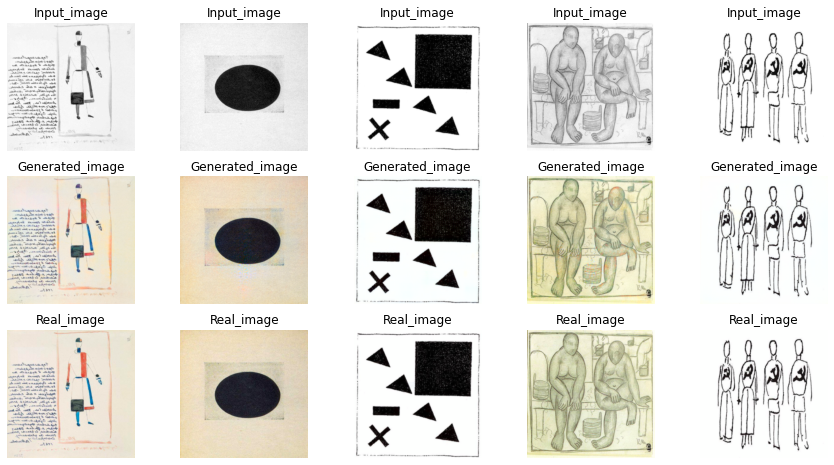

100%|██████████| 14/14 [00:09<00:00,  1.55it/s]


=> Saving checkpoint
=> Saving checkpoint


 64%|██████▍   | 9/14 [00:05<00:02,  1.95it/s]


Epoch 2/21
Iteration 10/14
disc_loss_gen: 0.70503
disc_loss_real: 0.68195
disc_loss: 0.69349
loss_G_GAN: 0.86874
loss_G_L1: 3.19874
loss_G: 4.06749


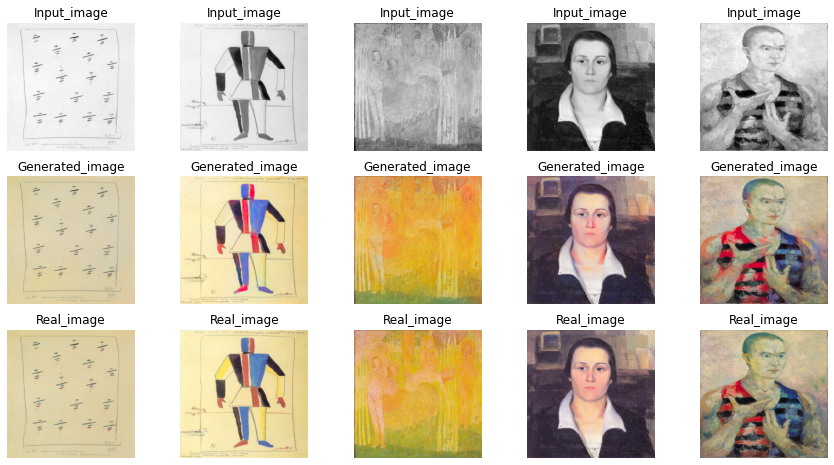

 64%|██████▍   | 9/14 [00:05<00:02,  1.93it/s]


Epoch 3/21
Iteration 10/14
disc_loss_gen: 0.65819
disc_loss_real: 0.68018
disc_loss: 0.66919
loss_G_GAN: 0.87103
loss_G_L1: 3.28882
loss_G: 4.15985


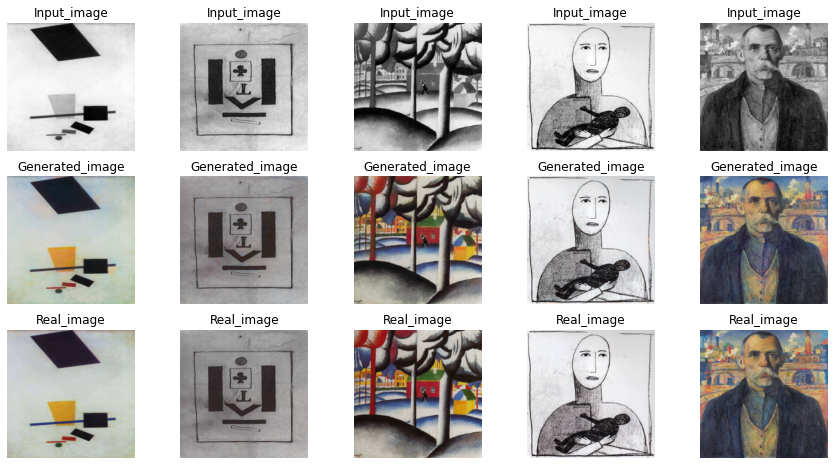

 64%|██████▍   | 9/14 [00:05<00:02,  1.85it/s]


Epoch 4/21
Iteration 10/14
disc_loss_gen: 0.64389
disc_loss_real: 0.69326
disc_loss: 0.66857
loss_G_GAN: 0.90232
loss_G_L1: 3.32079
loss_G: 4.22311


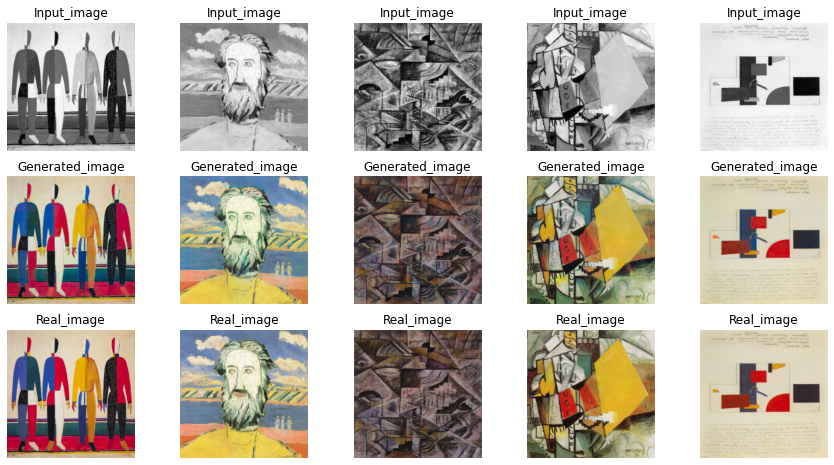

 64%|██████▍   | 9/14 [00:05<00:02,  1.90it/s]


Epoch 5/21
Iteration 10/14
disc_loss_gen: 0.74303
disc_loss_real: 0.67908
disc_loss: 0.71106
loss_G_GAN: 0.96322
loss_G_L1: 3.32589
loss_G: 4.28911


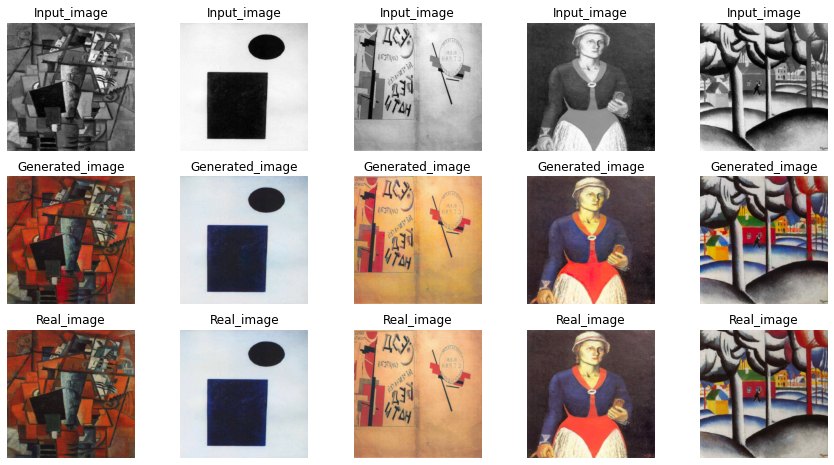

 64%|██████▍   | 9/14 [00:05<00:02,  1.93it/s]


Epoch 6/21
Iteration 10/14
disc_loss_gen: 0.64354
disc_loss_real: 0.66636
disc_loss: 0.65495
loss_G_GAN: 0.84110
loss_G_L1: 2.97883
loss_G: 3.81993


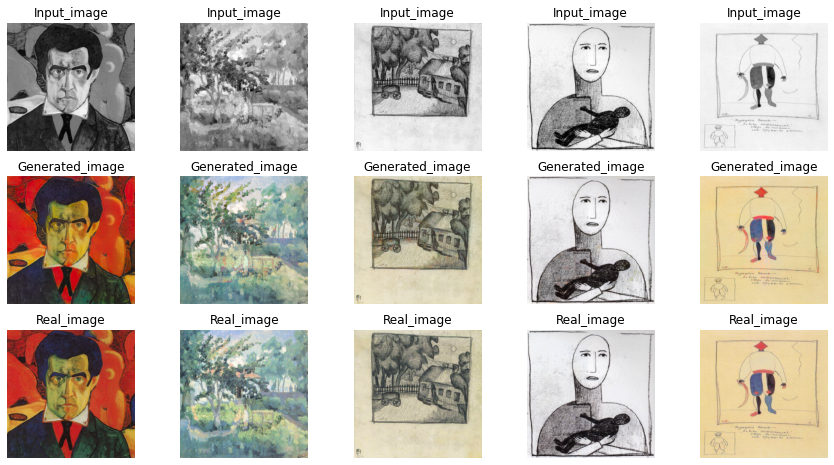

 64%|██████▍   | 9/14 [00:05<00:02,  1.95it/s]


Epoch 7/21
Iteration 10/14
disc_loss_gen: 0.63106
disc_loss_real: 0.71261
disc_loss: 0.67184
loss_G_GAN: 0.82032
loss_G_L1: 3.12329
loss_G: 3.94361


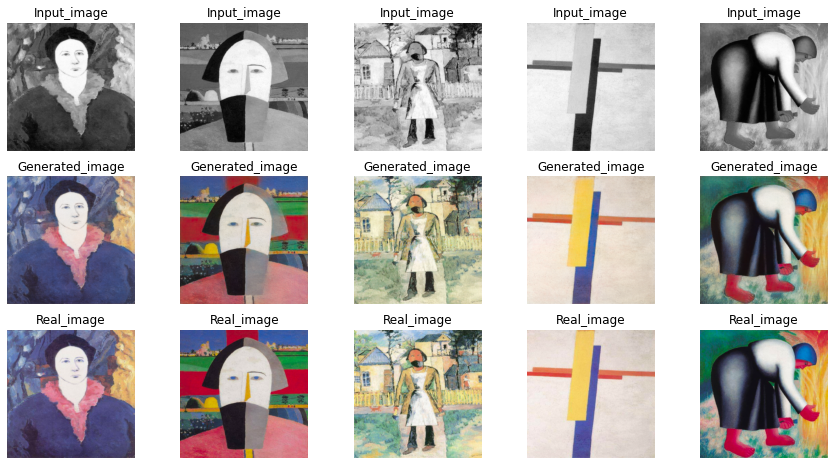

 64%|██████▍   | 9/14 [00:05<00:02,  1.96it/s]


Epoch 8/21
Iteration 10/14
disc_loss_gen: 0.67398
disc_loss_real: 0.68525
disc_loss: 0.67961
loss_G_GAN: 0.90217
loss_G_L1: 3.11251
loss_G: 4.01468


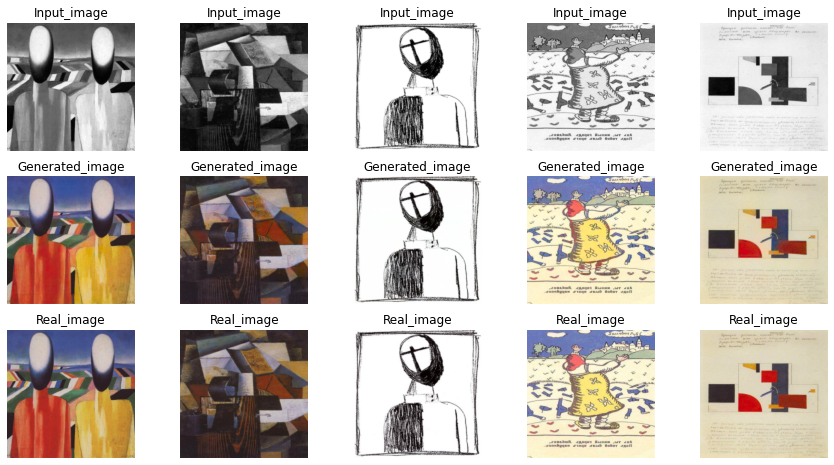

 64%|██████▍   | 9/14 [00:05<00:02,  1.97it/s]


Epoch 9/21
Iteration 10/14
disc_loss_gen: 0.62516
disc_loss_real: 0.69962
disc_loss: 0.66239
loss_G_GAN: 0.82444
loss_G_L1: 3.19256
loss_G: 4.01701


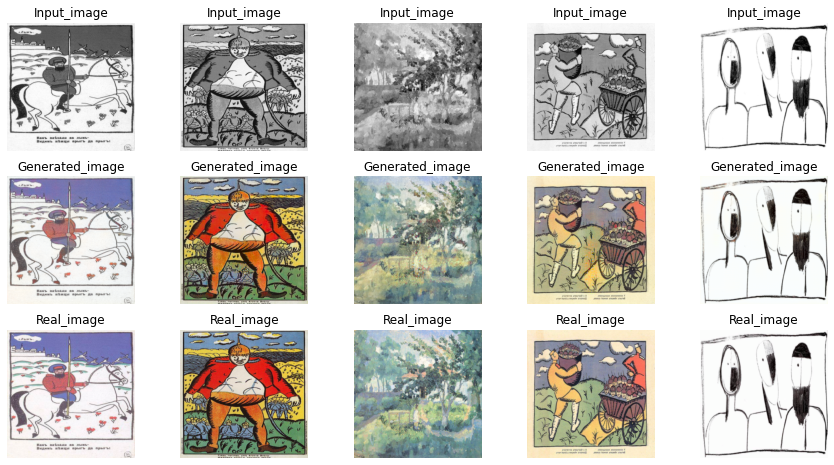

 64%|██████▍   | 9/14 [00:05<00:02,  1.96it/s]


Epoch 10/21
Iteration 10/14
disc_loss_gen: 0.65920
disc_loss_real: 0.64357
disc_loss: 0.65139
loss_G_GAN: 0.85369
loss_G_L1: 3.17488
loss_G: 4.02857


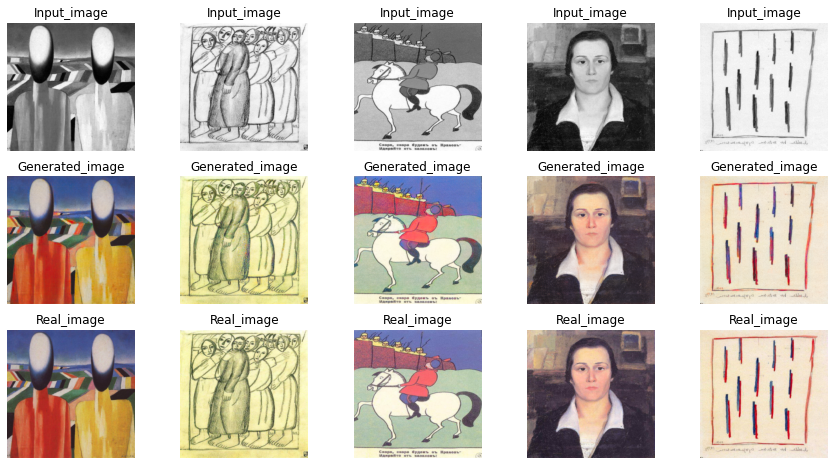

 64%|██████▍   | 9/14 [00:05<00:02,  1.93it/s]


Epoch 11/21
Iteration 10/14
disc_loss_gen: 0.68602
disc_loss_real: 0.73230
disc_loss: 0.70916
loss_G_GAN: 0.88065
loss_G_L1: 3.04511
loss_G: 3.92576


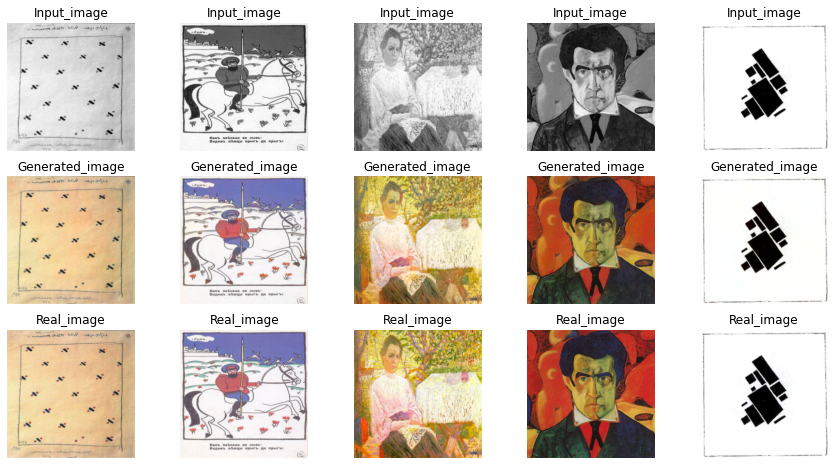

100%|██████████| 14/14 [00:08<00:00,  1.62it/s]


=> Saving checkpoint
=> Saving checkpoint


 64%|██████▍   | 9/14 [00:05<00:02,  1.94it/s]


Epoch 12/21
Iteration 10/14
disc_loss_gen: 0.66658
disc_loss_real: 0.65157
disc_loss: 0.65908
loss_G_GAN: 0.82459
loss_G_L1: 3.07860
loss_G: 3.90319


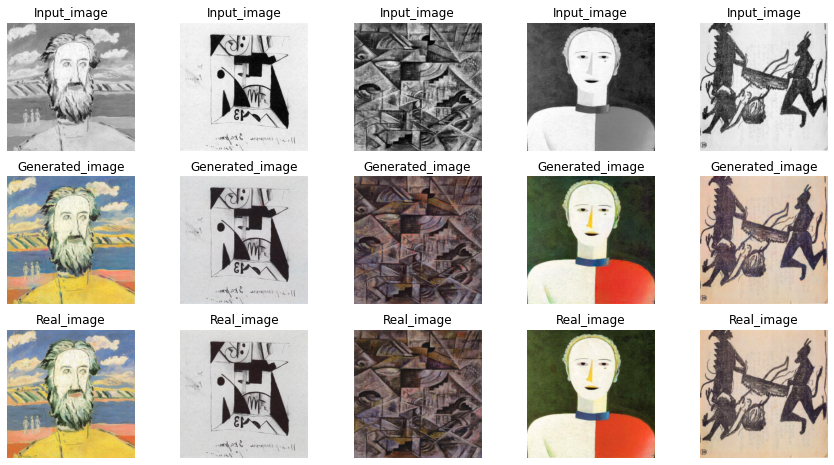

 64%|██████▍   | 9/14 [00:05<00:02,  1.91it/s]


Epoch 13/21
Iteration 10/14
disc_loss_gen: 0.69036
disc_loss_real: 0.69408
disc_loss: 0.69222
loss_G_GAN: 0.86993
loss_G_L1: 2.99440
loss_G: 3.86434


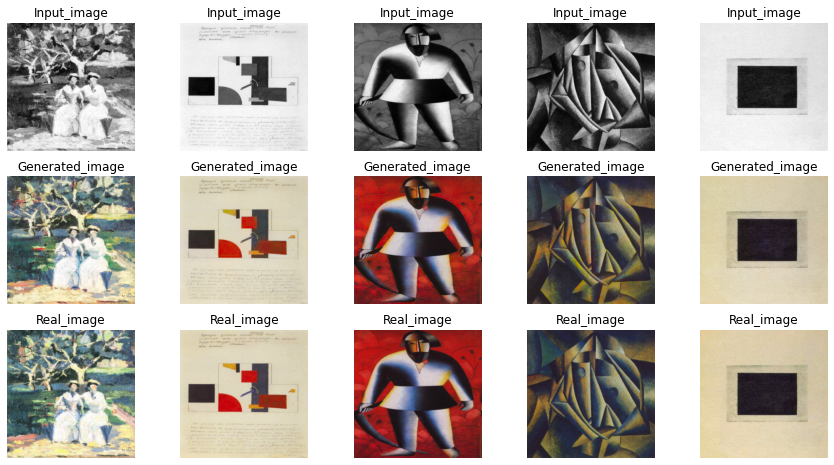

 64%|██████▍   | 9/14 [00:05<00:02,  1.93it/s]


Epoch 14/21
Iteration 10/14
disc_loss_gen: 0.63639
disc_loss_real: 0.63950
disc_loss: 0.63794
loss_G_GAN: 0.82185
loss_G_L1: 3.24727
loss_G: 4.06911


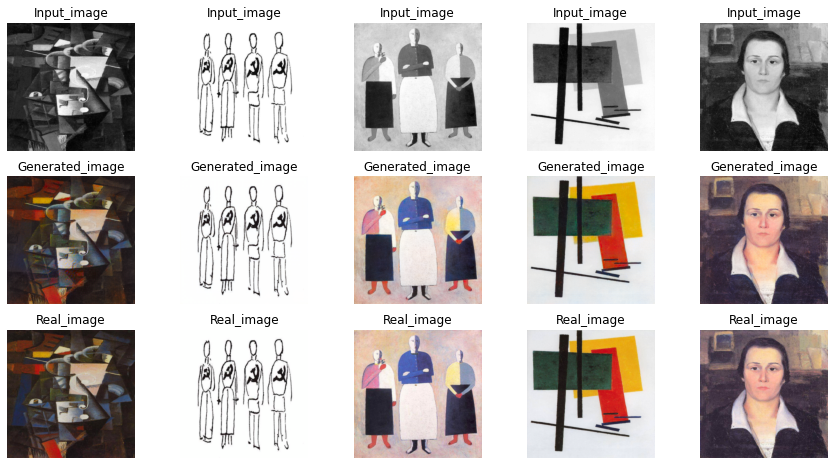

 64%|██████▍   | 9/14 [00:05<00:02,  1.94it/s]


Epoch 15/21
Iteration 10/14
disc_loss_gen: 0.69938
disc_loss_real: 0.66294
disc_loss: 0.68116
loss_G_GAN: 0.86595
loss_G_L1: 3.21748
loss_G: 4.08343


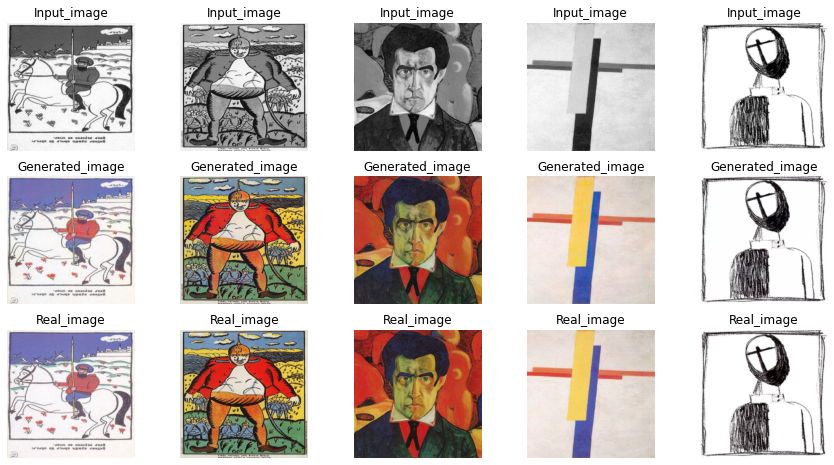

 64%|██████▍   | 9/14 [00:05<00:02,  1.93it/s]


Epoch 16/21
Iteration 10/14
disc_loss_gen: 0.68400
disc_loss_real: 0.69955
disc_loss: 0.69177
loss_G_GAN: 0.86062
loss_G_L1: 3.00923
loss_G: 3.86985


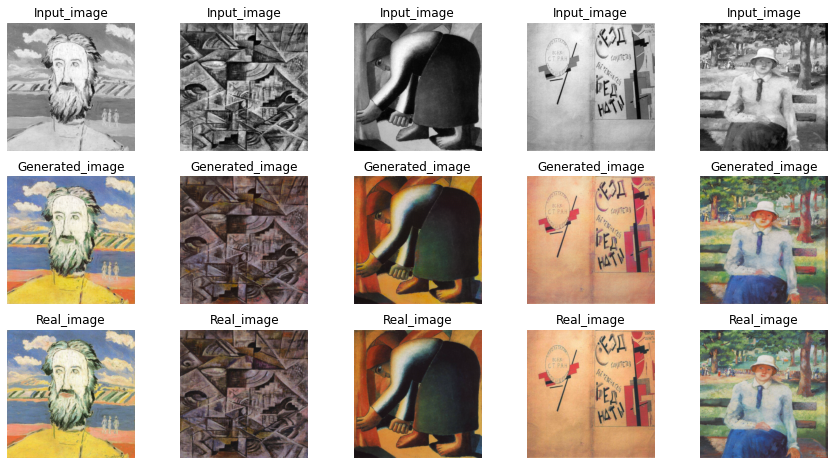

 64%|██████▍   | 9/14 [00:05<00:02,  1.96it/s]


Epoch 17/21
Iteration 10/14
disc_loss_gen: 0.67863
disc_loss_real: 0.67453
disc_loss: 0.67658
loss_G_GAN: 0.88560
loss_G_L1: 2.87957
loss_G: 3.76516


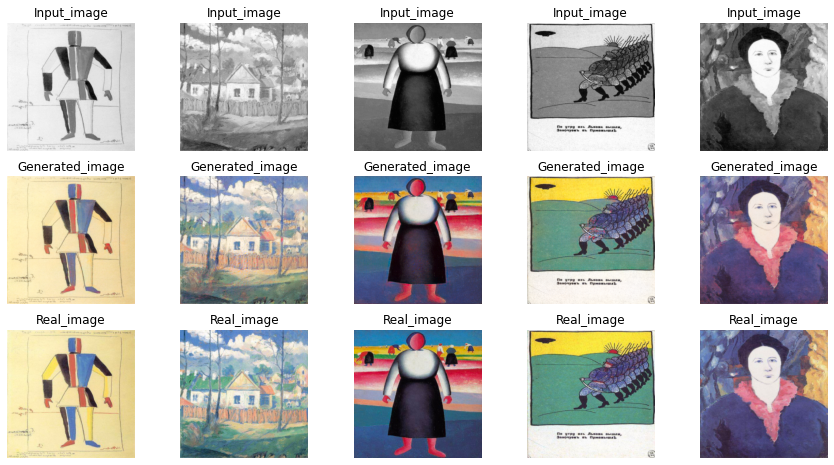

 64%|██████▍   | 9/14 [00:05<00:02,  1.92it/s]


Epoch 18/21
Iteration 10/14
disc_loss_gen: 0.68388
disc_loss_real: 0.65647
disc_loss: 0.67017
loss_G_GAN: 0.89337
loss_G_L1: 2.92885
loss_G: 3.82222


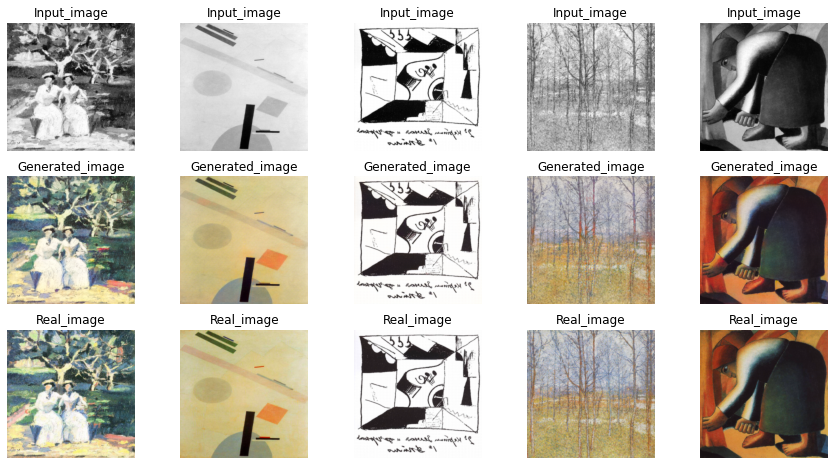

 64%|██████▍   | 9/14 [00:05<00:02,  1.95it/s]


Epoch 19/21
Iteration 10/14
disc_loss_gen: 0.70216
disc_loss_real: 0.61223
disc_loss: 0.65720
loss_G_GAN: 0.85088
loss_G_L1: 3.00422
loss_G: 3.85509


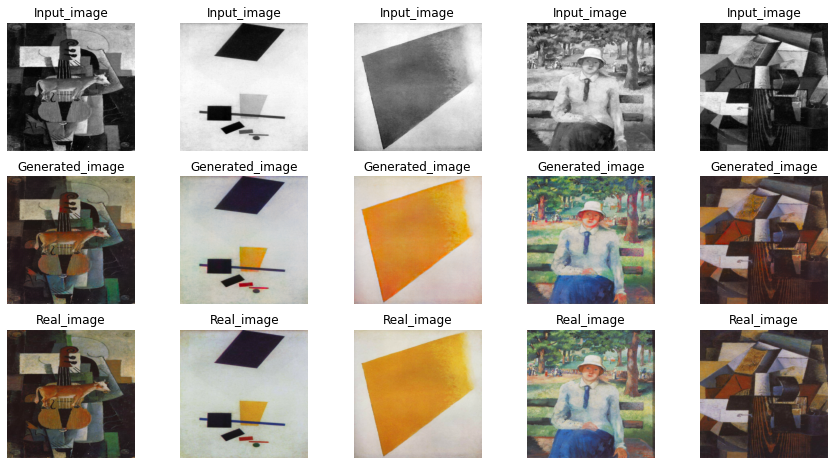

 64%|██████▍   | 9/14 [00:05<00:02,  1.95it/s]


Epoch 20/21
Iteration 10/14
disc_loss_gen: 0.69191
disc_loss_real: 0.71447
disc_loss: 0.70319
loss_G_GAN: 0.81993
loss_G_L1: 2.94350
loss_G: 3.76343


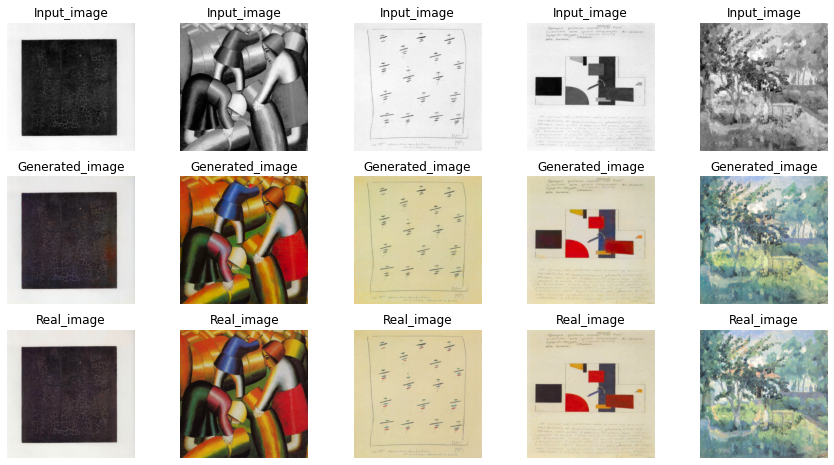

 64%|██████▍   | 9/14 [00:05<00:02,  1.96it/s]


Epoch 21/21
Iteration 10/14
disc_loss_gen: 0.67339
disc_loss_real: 0.62559
disc_loss: 0.64949
loss_G_GAN: 0.84183
loss_G_L1: 2.80379
loss_G: 3.64562


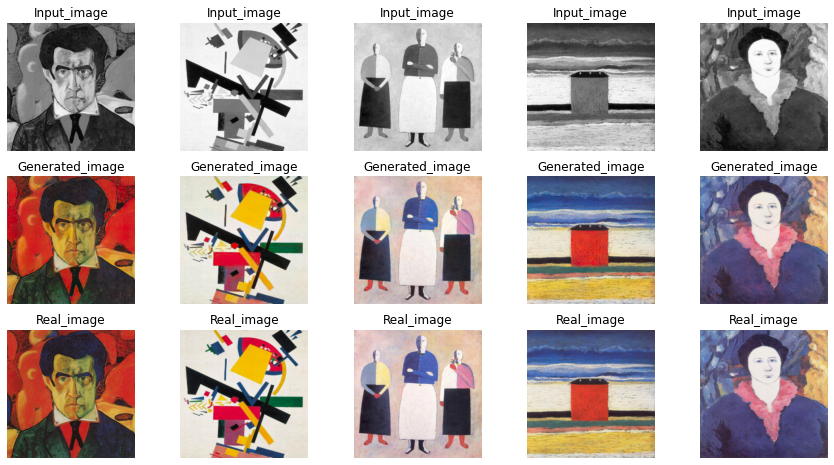

100%|██████████| 14/14 [00:08<00:00,  1.62it/s]


=> Saving checkpoint
=> Saving checkpoint


In [39]:
print(TRAIN_DIR)
if LOAD_MODEL:
    generator = Generator().to(DEVICE)
    discriminator = Discriminator().to(DEVICE)
    gen_optim = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(0.05, 0.999))
    disc_optim= optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(0.05, 0.999))
    load_checkpoint(CHECKPOINT_GEN_PATH, generator, gen_optim, lr=LEARNING_RATE)
    load_checkpoint(CHECKPOINT_DISC_PATH, discriminator, disc_optim, lr=LEARNING_RATE)
   
    model = Pix2Pix(generator=generator, discriminator=discriminator)
    
else:
    model = Pix2Pix()
train_model(model, train_loader, epochs=21, display=10)


In [24]:

def gen_and_print(path, LOAD_MODEL=False, CHECKPOINT_GEN_PATH=CHECKPOINT_GEN_PATH, CHECKPOINT_DISC_PATH=CHECKPOINT_DISC_PATH):
    if LOAD_MODEL:
        generator = Generator().to(DEVICE)
        discriminator = Discriminator().to(DEVICE)
        gen_optim = optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(0.05, 0.999))
        disc_optim= optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(0.05, 0.999))
        load_checkpoint(CHECKPOINT_GEN_PATH, generator, gen_optim, lr=LEARNING_RATE)
        load_checkpoint(CHECKPOINT_DISC_PATH, discriminator, disc_optim, lr=LEARNING_RATE)
   
        model = Pix2Pix(generator=generator, discriminator=discriminator)
    
    img = Image.open(path)
    img = img.resize((256, 256))
    img_t = np.array(img)
    lab = rgb2lab(img).astype("float32")
    lab = tt.ToTensor()(lab)
    L = lab[[0],...]/50 - 1 # Standardizing L space

    model.eval()
    with torch.no_grad():
        preds = model.generator(L.unsqueeze(0).to(DEVICE))
        gen_output = lab_to_rgb(L.unsqueeze(0), preds.cpu())[0]

    images = [img, gen_output]
    titles = ['real','generated']

    fig, ax = plt.subplots(1, 2, figsize=(20,20))
    for idx,img in enumerate(images):
        ax[idx].imshow(img)
        ax[idx].axis("off")
    for idx, title in enumerate(titles):    
        ax[idx].set_title('{}'.format(title))
    plt.show()
    


=> Loading checkpoint
=> Loading checkpoint


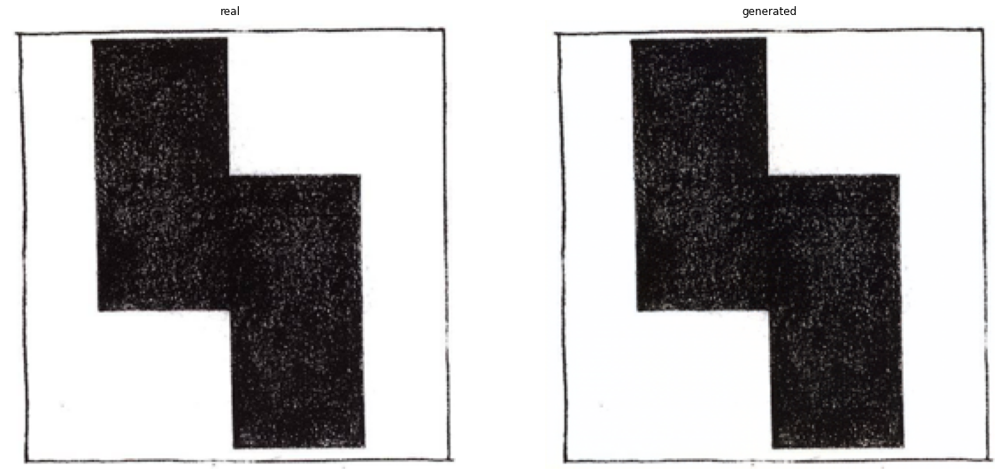

=> Loading checkpoint
=> Loading checkpoint


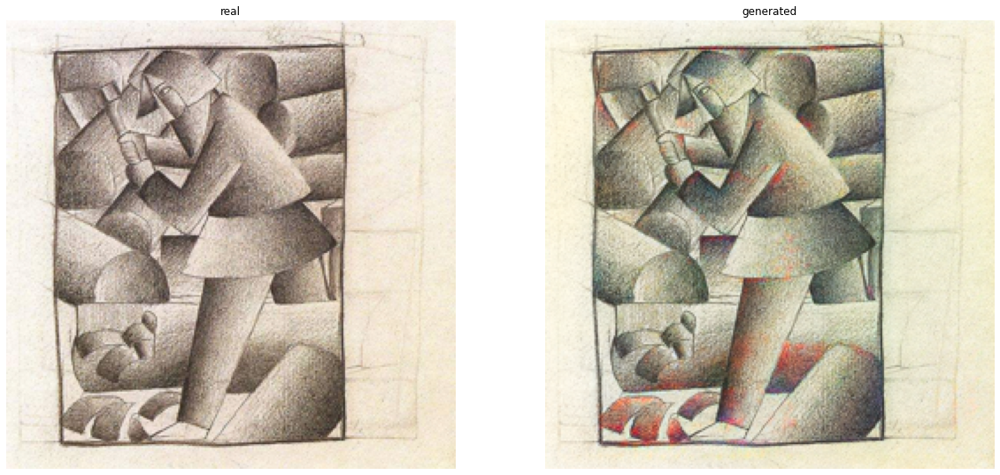

=> Loading checkpoint
=> Loading checkpoint


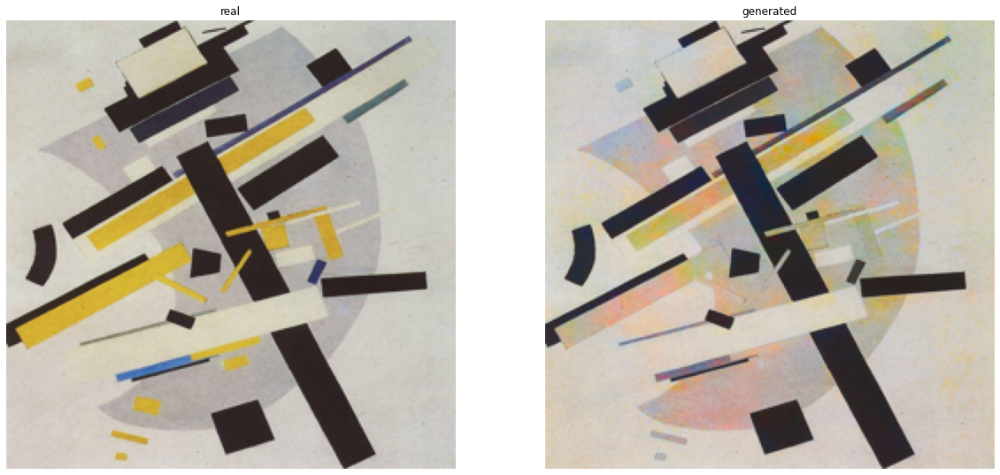

=> Loading checkpoint
=> Loading checkpoint


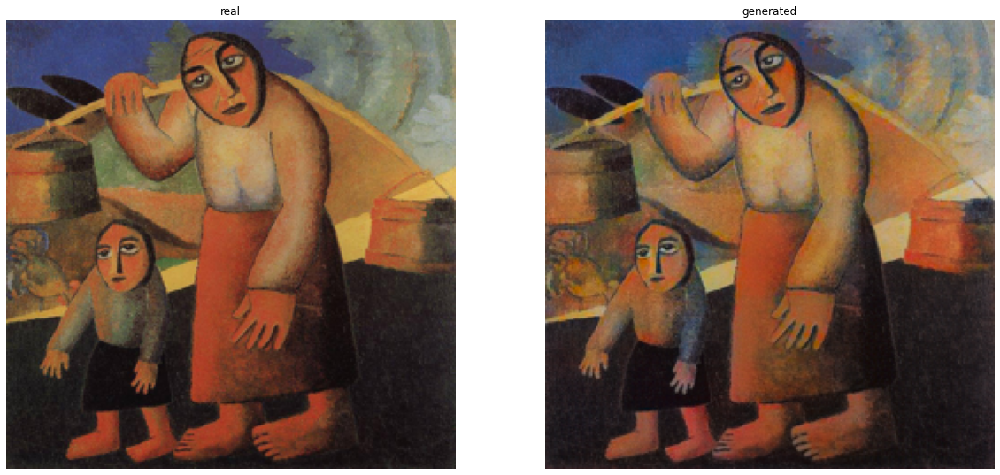

=> Loading checkpoint
=> Loading checkpoint


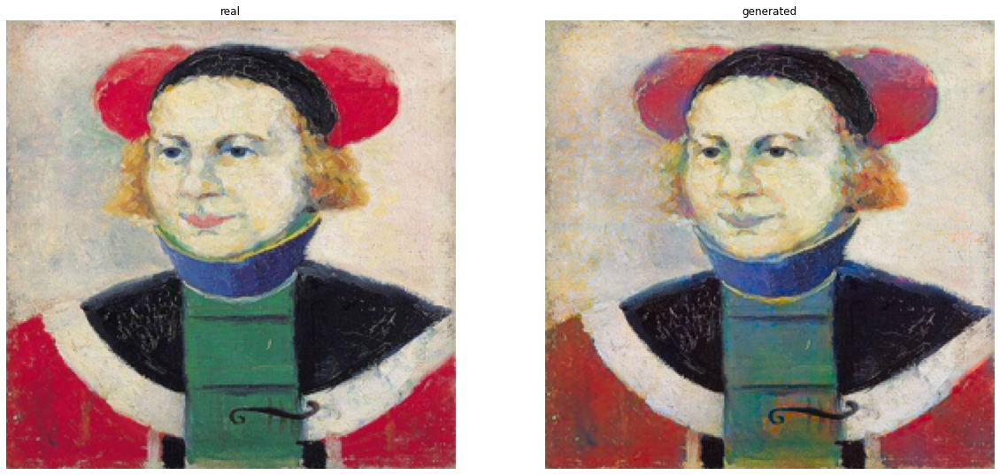

=> Loading checkpoint
=> Loading checkpoint


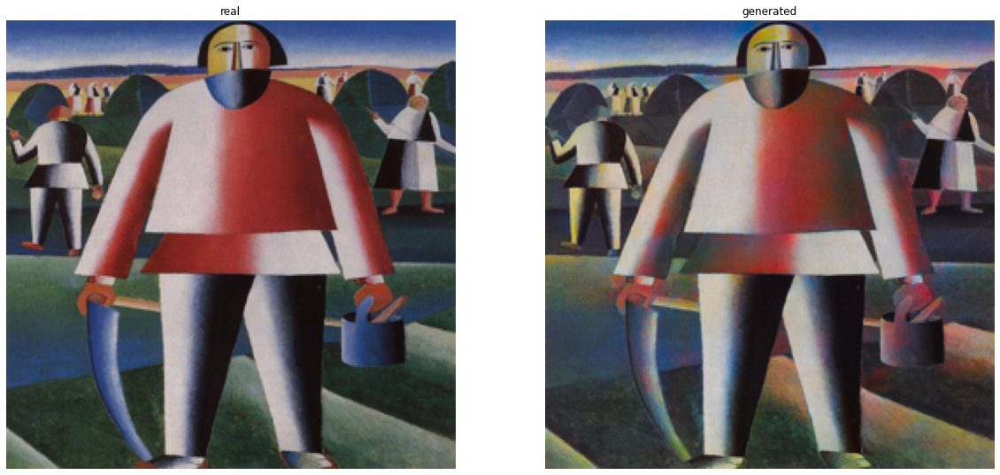

=> Loading checkpoint
=> Loading checkpoint


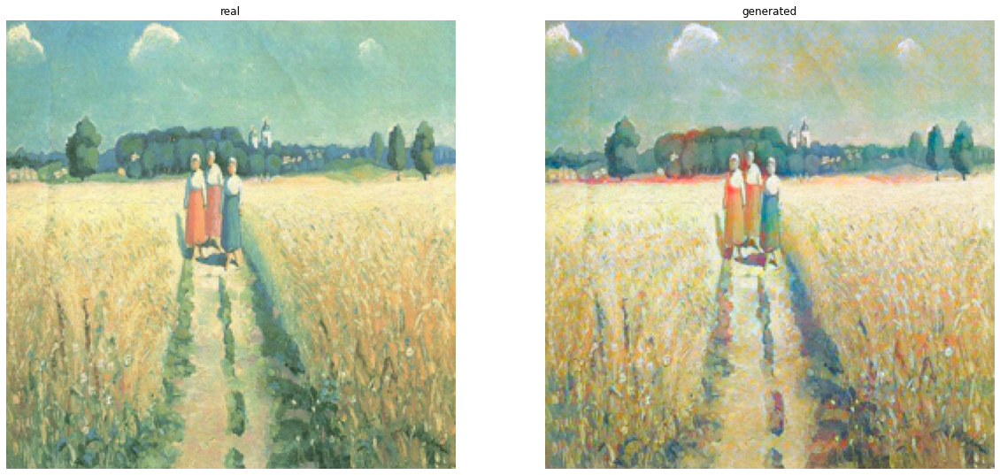

=> Loading checkpoint
=> Loading checkpoint


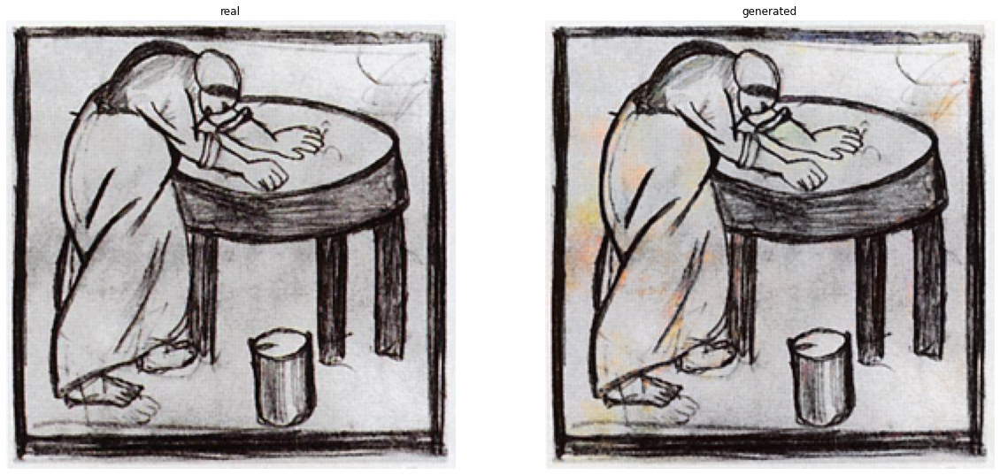

=> Loading checkpoint
=> Loading checkpoint


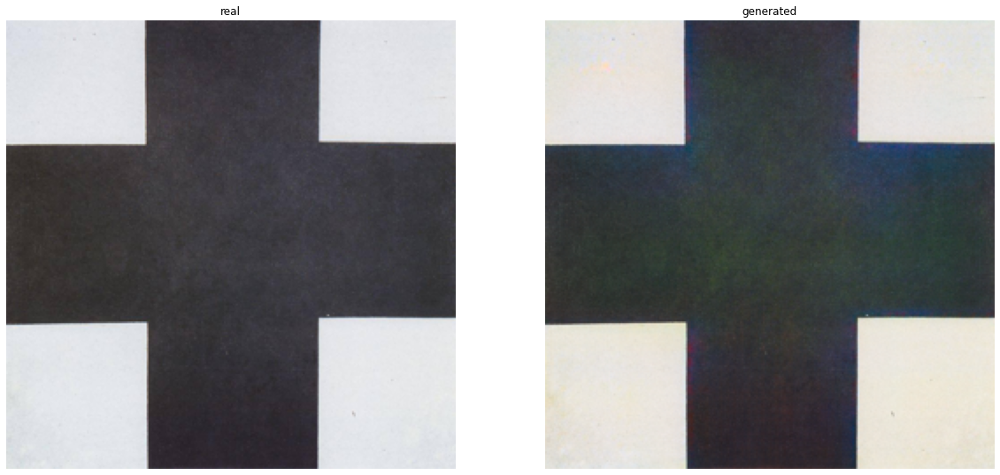

=> Loading checkpoint
=> Loading checkpoint


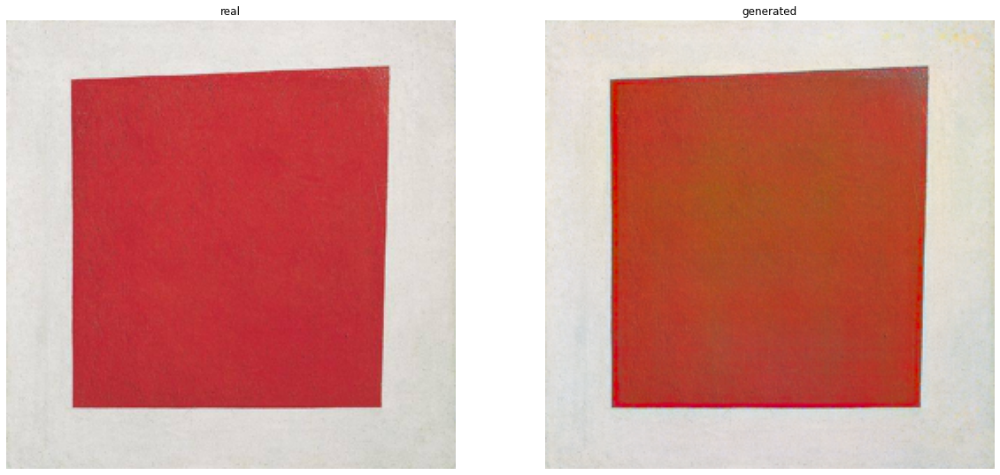

=> Loading checkpoint
=> Loading checkpoint


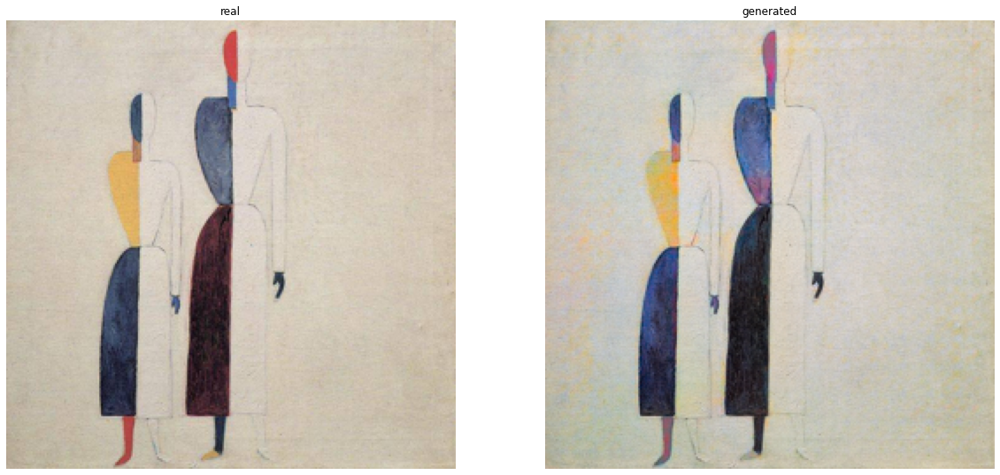

=> Loading checkpoint
=> Loading checkpoint


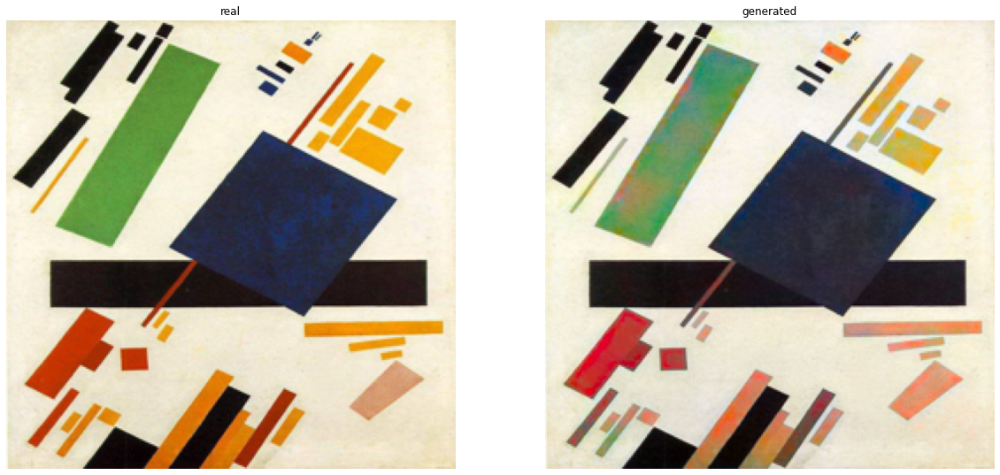

=> Loading checkpoint
=> Loading checkpoint


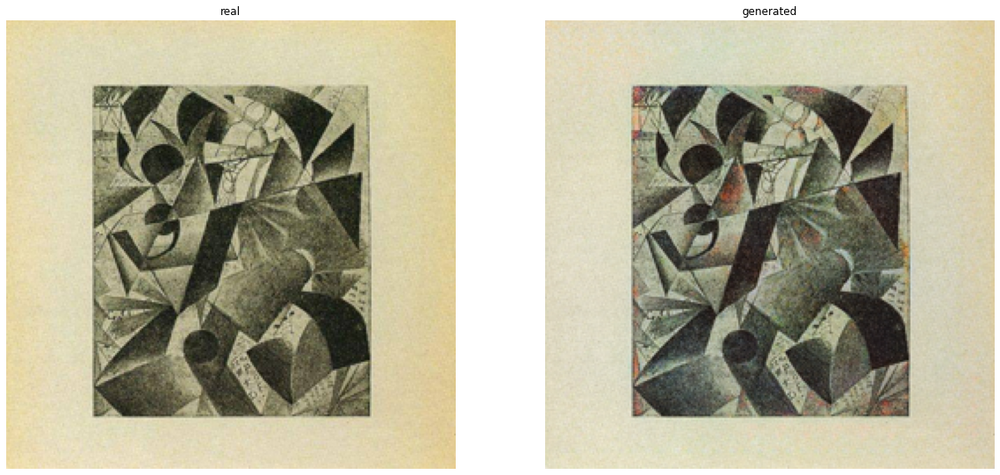

=> Loading checkpoint
=> Loading checkpoint


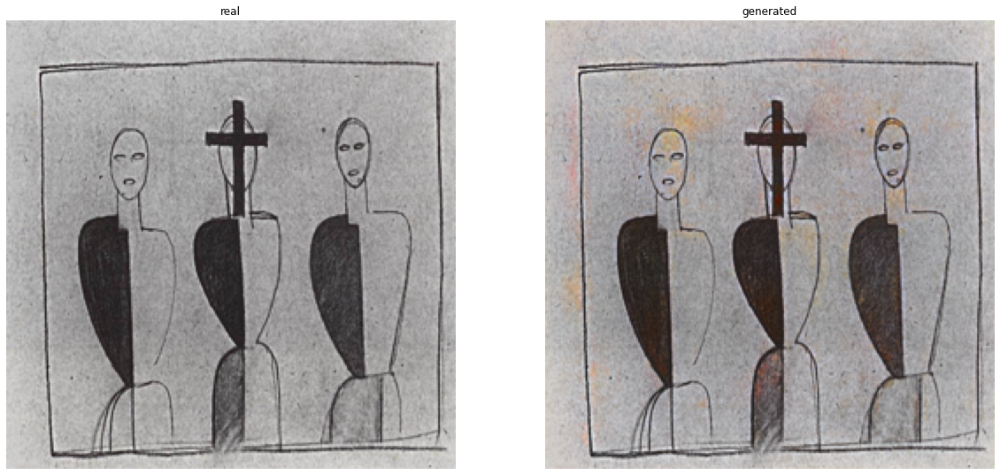

=> Loading checkpoint
=> Loading checkpoint


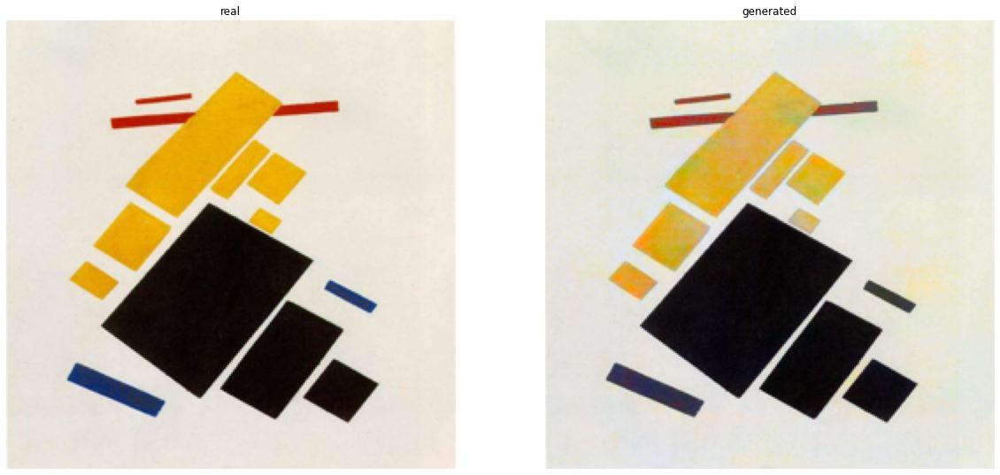

=> Loading checkpoint
=> Loading checkpoint


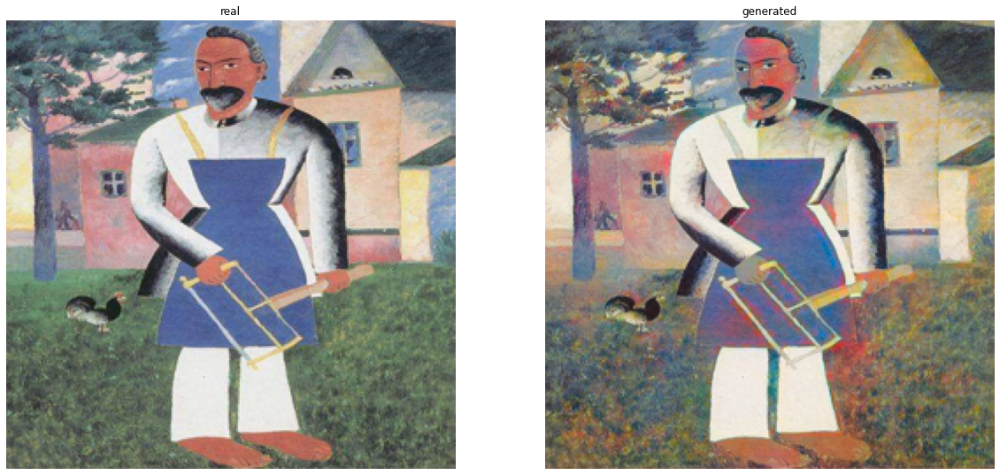

In [41]:
for i in range (111,127):
    path = f"{VAL_DIR}/Kazimir_Malevich_{i}.jpg"
    gen_and_print(path, LOAD_MODEL=True, CHECKPOINT_GEN_PATH=CHECKPOINT_GEN_PATH, CHECKPOINT_DISC_PATH=CHECKPOINT_DISC_PATH)
    